# Poincare Boundary Condition

Most of the tutorials use last closed flux surface (LCFS) as the boundary condition for 3D equilibrium. This tutorial will cover another way to define boundary condition using DESC.

In [1]:
import sys
import os

sys.path.insert(0, os.path.abspath("."))
sys.path.append(os.path.abspath("../../"))

If you have access to a GPU, uncomment the following two lines. 

In [2]:
from desc import set_device
set_device("gpu")

As mentioned in [DESC Documentation on performance tips](https://desc-docs.readthedocs.io/en/latest/performance_tips.html), one can use compilation cache directory to reduce the compilation overhead time. Note: One needs to create `jax-caches` folder manually.

In [3]:
# import jax

# jax.config.update("jax_compilation_cache_dir", "../jax-caches")
# jax.config.update("jax_persistent_cache_min_entry_size_bytes", -1)
# jax.config.update("jax_persistent_cache_min_compile_time_secs", 0)

In [4]:
%matplotlib inline
import numpy as np

from desc.io import load
from desc.equilibrium import EquilibriaFamily, Equilibrium
from desc.continuation import solve_continuation_automatic
from desc.optimize import Optimizer
from desc.grid import LinearGrid
from desc.objectives import (
    ObjectiveFunction,
    ForceBalance,
    FixCurrent,
    FixSectionLambda,
    FixSectionR,
    FixSectionZ,
    FixBoundaryR,
    FixBoundaryZ,
    FixPressure,
    FixPsi,
    FixIota,
    QuasisymmetryTwoTerm,
    AspectRatio,
    Elongation,
    Volume,
    get_fixed_xsection_constraints,
    get_fixed_boundary_constraints,
)
from desc.examples import get
from desc.plotting import *
from desc.geometry import ZernikeRZToroidalSection, FourierRZToroidalSurface
from desc.backend import print_backend_info

import plotly.express as px
import plotly.io as pio

# This ensures Plotly output works in multiple places:
# plotly_mimetype: VS Code notebook UI
# notebook: "Jupyter: Export to HTML" command in VS Code
# See https://plotly.com/python/renderers/#multiple-renderers
pio.renderers.default = "plotly_mimetype+notebook"

print_backend_info()

DESC version=0.15.0+423.g9d6319741.dirty.
Using JAX backend: jax version=0.6.2, jaxlib version=0.6.2, dtype=float64.
Using device: NVIDIA GeForce RTX 4080 Laptop GPU (id=0), with 9.85 GB available memory.


## Optimization with Poincare Solve

**Note**: I added this section to discuss eligibility of Poincare solve for optimization. The result is pretty bad in this state.

During equilibrium optimization, if a user gives `ForceBalance` as constraint, DESC automatically uses `proximal-lsq-exact` which solve the equilibrium at each optimization step to preserve the MHD force balance. This internal equilibrium solve use fixed-boundary constraint by default. However, this can be changed to fixed-Poincare section solve, if user adds one of the `FixSection...` constraints instead of `FixBoundary...` constraints. Let's see an example!

We will conduct a similar optimization as shown in `desc.examples.precise_QH.py`.

In [ ]:
try:
    eq = load("poincare_precise_QH_initial_eq.h5")
    eq.xsection = eq.get_surface_at(zeta=0)
    eq.surface = eq.get_surface_at(rho=1)
except FileNotFoundError:
    eq = load("../../desc/examples/precise_QH_output.h5")[0]
    constraints = get_fixed_xsection_constraints(eq=eq)
    objective = ObjectiveFunction(ForceBalance(eq))

    # before optimization make sure that the initial equilibrium
    # is in force balance in terms of poincare constraints
    eq.solve(
        verbose=0,
        objective=objective,
        constraints=constraints,
        maxiter=100,
        ftol=1e-3,
    );
    eq.xsection = eq.get_surface_at(zeta=0)
    eq.surface = eq.get_surface_at(rho=1)
    eq.save("poincare_precise_QH_initial_eq.h5")

In [55]:
V = eq.compute("V")["V"]
eqfam = EquilibriaFamily(eq)

# grid for computing quasisymmetry objective
grid = LinearGrid(M=eq.M, N=eq.N, NFP=eq.NFP, rho=np.array([0.6, 0.8, 1.0]), sym=True)

In [56]:
def run_step(n, eqfam, ftol=1e-2, fix_lambda=False, fix_R0=False, **kwargs):
    print("\n==================================")
    print("Optimizing boundary modes L,M <= {}".format(n))
    print("====================================")
    objective = ObjectiveFunction(
        (
            QuasisymmetryTwoTerm(
                eq=eqfam[-1],
                helicity=(1, eqfam[-1].NFP),
                grid=grid,
                normalize=False,
                weight=1e0,
            ),
            AspectRatio(eq=eqfam[-1], target=8, weight=1e1, normalize=False),
            Volume(eq=eqfam[-1], target=V, weight=1e3, normalize=False),
        ),
    )
    bc_surf = eqfam[-1].xsection
    if fix_R0:
        R_modes = np.vstack(
            (
                [0, 0, 0],
                bc_surf.R_basis.modes[np.max(np.abs(bc_surf.R_basis.modes), 1) > n, :],
            )
        )
    else:
        R_modes = bc_surf.R_basis.modes[np.max(np.abs(bc_surf.R_basis.modes), 1) > n, :]
    Z_modes = bc_surf.Z_basis.modes[np.max(np.abs(bc_surf.Z_basis.modes), 1) > n, :]
    constraints = (
        ForceBalance(eq=eqfam[-1]),
        FixSectionR(eq=eqfam[-1], modes=R_modes),
        FixSectionZ(eq=eqfam[-1], modes=Z_modes),
        FixPressure(eq=eqfam[-1]),
        FixCurrent(eq=eqfam[-1]),
        FixPsi(eq=eqfam[-1]),
    )
    if fix_lambda:
        L_modes = bc_surf.L_basis.modes[np.max(np.abs(bc_surf.L_basis.modes), 1) > n, :]
        constraints += (FixSectionLambda(eq=eqfam[-1], modes=L_modes),)

    optimizer = Optimizer("proximal-lsq-exact")
    eq_new, _ = eqfam[-1].optimize(
        objective=objective,
        constraints=constraints,
        optimizer=optimizer,
        maxiter=25,
        verbose=3,
        ftol=ftol,
        copy=True,
        options={
            "perturb_options": {"verbose": 0},
            "solve_options": {"verbose": 0, "ftol": 1e-3, "maxiter": 250},
            **kwargs,
        },
    )
    eqfam.append(eq_new)
    return eqfam


Optimizing boundary modes L,M <= 1
Building objective: QS two-term
Precomputing transforms
Timer: Precomputing transforms = 58.3 ms
Building objective: aspect ratio
Precomputing transforms
Timer: Precomputing transforms = 28.5 ms
Building objective: volume
Precomputing transforms
Timer: Precomputing transforms = 30.9 ms
Timer: Objective build = 135 ms
Building objective: force
Precomputing transforms
Timer: Precomputing transforms = 64.7 ms
Timer: Objective build = 77.7 ms
Timer: Objective build = 1.64 ms
Timer: Eq Update LinearConstraintProjection build = 145 ms
Timer: Proximal projection build = 52.6 sec
Building objective: fixed cross-section R
Building objective: fixed cross-section Z
Building objective: fixed pressure
Building objective: fixed current
Building objective: fixed Psi
Timer: Objective build = 149 ms
Timer: LinearConstraintProjection build = 183 ms
Number of parameters: 3
Number of objectives: 461
Timer: Initializing the optimization = 53.0 sec

Starting optimization


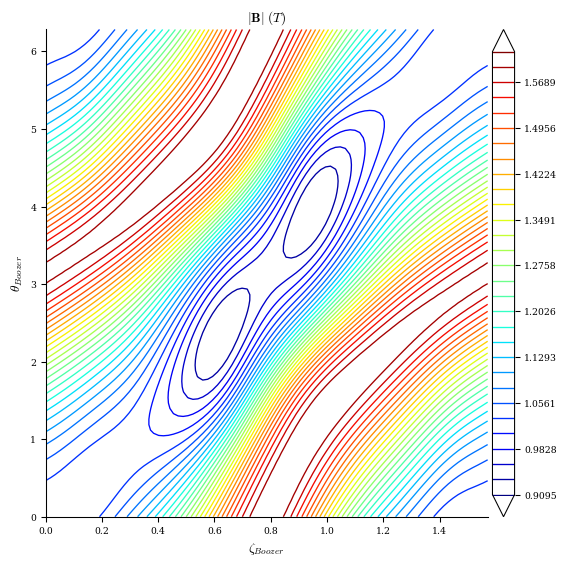

In [57]:
eqfam = run_step(1, eqfam, ftol=1e-3)
plot_boozer_surface(eqfam[-1]);


Optimizing boundary modes L,M <= 2
Building objective: QS two-term
Precomputing transforms
Timer: Precomputing transforms = 63.1 ms
Building objective: aspect ratio
Precomputing transforms
Timer: Precomputing transforms = 28.7 ms
Building objective: volume
Precomputing transforms
Timer: Precomputing transforms = 29.0 ms
Timer: Objective build = 136 ms
Building objective: force
Precomputing transforms
Timer: Precomputing transforms = 68.1 ms
Timer: Objective build = 83.6 ms
Timer: Objective build = 1.05 ms
Timer: Eq Update LinearConstraintProjection build = 185 ms
Timer: Proximal projection build = 4.95 sec
Building objective: fixed cross-section R
Building objective: fixed cross-section Z
Building objective: fixed pressure
Building objective: fixed current
Building objective: fixed Psi
Timer: Objective build = 163 ms
Timer: LinearConstraintProjection build = 193 ms
Number of parameters: 6
Number of objectives: 461
Timer: Initializing the optimization = 5.35 sec

Starting optimization


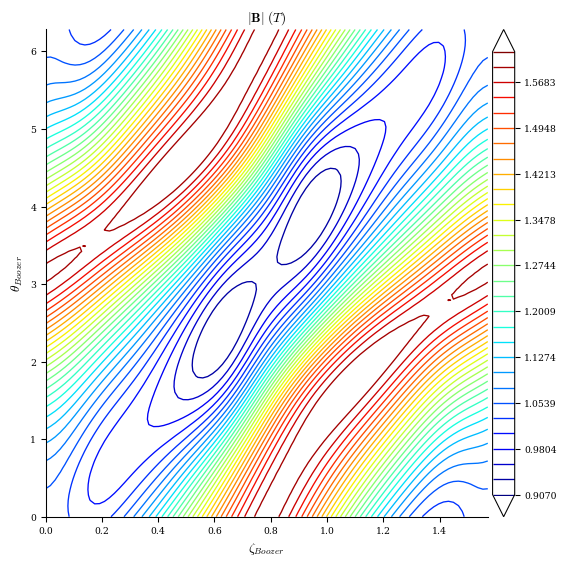

In [58]:
eqfam = run_step(2, eqfam, ftol=1e-3)
plot_boozer_surface(eqfam[-1]);


Optimizing boundary modes L,M <= 3
Building objective: QS two-term
Precomputing transforms
Timer: Precomputing transforms = 60.6 ms
Building objective: aspect ratio
Precomputing transforms
Timer: Precomputing transforms = 29.1 ms
Building objective: volume
Precomputing transforms
Timer: Precomputing transforms = 27.1 ms
Timer: Objective build = 129 ms
Building objective: force
Precomputing transforms
Timer: Precomputing transforms = 72.9 ms
Timer: Objective build = 92.6 ms
Timer: Objective build = 1.05 ms
Timer: Eq Update LinearConstraintProjection build = 200 ms
Timer: Proximal projection build = 4.33 sec
Building objective: fixed cross-section R
Building objective: fixed cross-section Z
Building objective: fixed pressure
Building objective: fixed current
Building objective: fixed Psi
Timer: Objective build = 179 ms
Timer: LinearConstraintProjection build = 202 ms
Number of parameters: 10
Number of objectives: 461
Timer: Initializing the optimization = 4.76 sec

Starting optimization

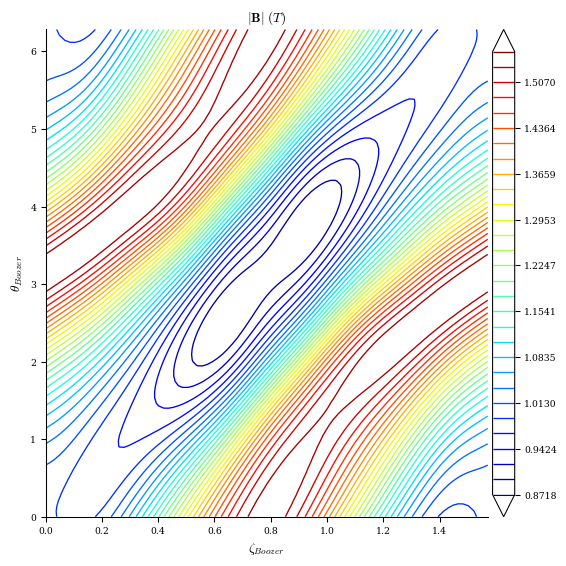

In [59]:
eqfam = run_step(3, eqfam, ftol=1e-3)
plot_boozer_surface(eqfam[-1]);


Optimizing boundary modes L,M <= 3
Building objective: QS two-term
Precomputing transforms
Timer: Precomputing transforms = 59.0 ms
Building objective: aspect ratio
Precomputing transforms
Timer: Precomputing transforms = 31.2 ms
Building objective: volume
Precomputing transforms
Timer: Precomputing transforms = 28.8 ms
Timer: Objective build = 132 ms
Building objective: force
Precomputing transforms
Timer: Precomputing transforms = 68.7 ms
Timer: Objective build = 86.8 ms
Timer: Objective build = 1.11 ms
Timer: Eq Update LinearConstraintProjection build = 239 ms
Timer: Proximal projection build = 4.49 sec
Building objective: fixed cross-section R
Building objective: fixed cross-section Z
Building objective: fixed pressure
Building objective: fixed current
Building objective: fixed Psi
Timer: Objective build = 159 ms
Timer: LinearConstraintProjection build = 177 ms
Number of parameters: 10
Number of objectives: 461
Timer: Initializing the optimization = 4.88 sec

Starting optimization

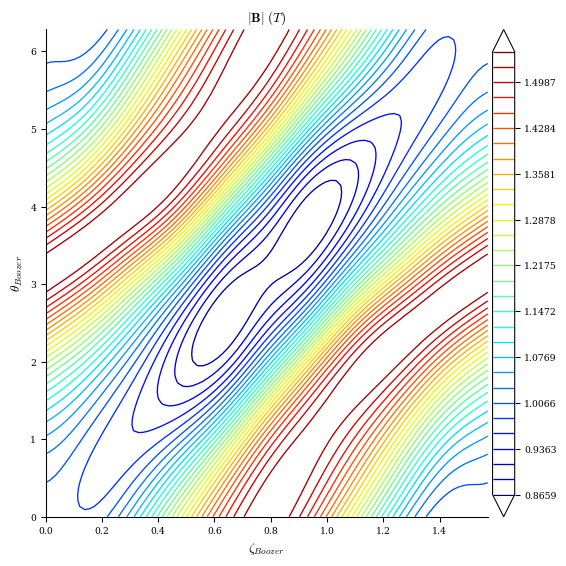

In [62]:
eqfam = run_step(3, eqfam, ftol=1e-3)
plot_boozer_surface(eqfam[-1]);

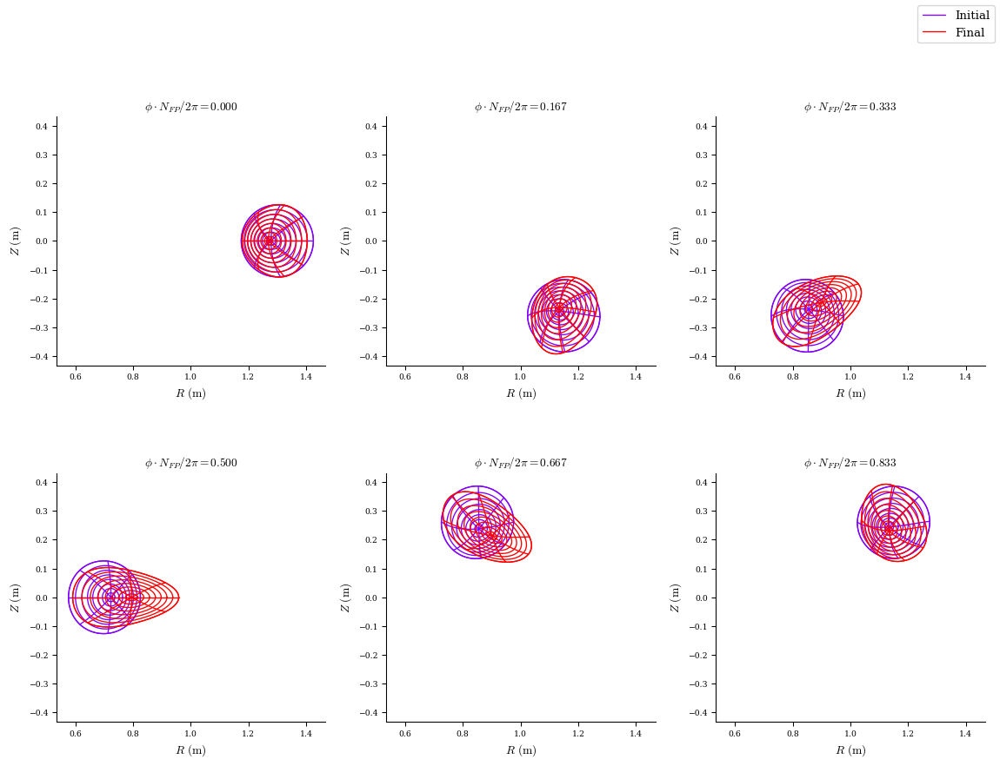

In [63]:
plot_comparison(eqs=[eqfam[0], eqfam[-1]], labels=["Initial", "Final"]);

In [64]:
plot_3d(eqfam[-1], "|B|")

/CODES/DESC/desc/utils.py:572: UserWarning:

Unequal number of field periods for grid 1 and basis 4.

/CODES/DESC/desc/utils.py:572: UserWarning:

Unequal number of field periods for grid 1 and basis 4.



In [65]:
eq00 = get("precise_QH")
fig = plot_3d(eqfam[-1], "|B|")
plot_3d(eq00, "|B|", fig=fig)

/CODES/DESC/desc/utils.py:572: UserWarning:

Unequal number of field periods for grid 1 and basis 4.

/CODES/DESC/desc/utils.py:572: UserWarning:

Unequal number of field periods for grid 1 and basis 4.

/CODES/DESC/desc/utils.py:572: UserWarning:

Unequal number of field periods for grid 1 and basis 4.

/CODES/DESC/desc/utils.py:572: UserWarning:

Unequal number of field periods for grid 1 and basis 4.



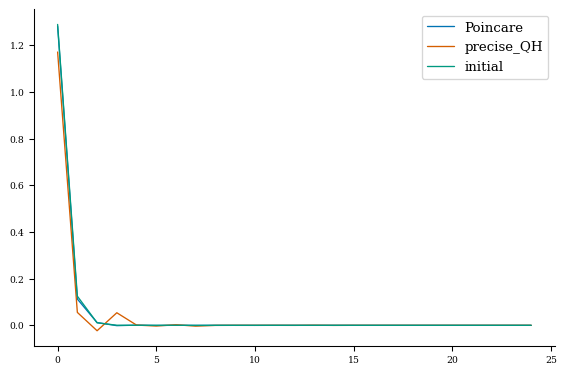

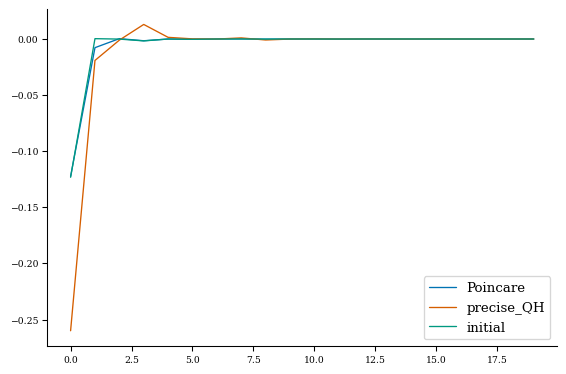

In [66]:
import matplotlib.pyplot as plt
eq00 = get("precise_QH")
eqp = eqfam[-1].copy()
eqp.xsection = eqp.get_surface_at(zeta=0)
eqp.surface = eqp.get_surface_at(rho=1)
eq00.xsection = eq00.get_surface_at(zeta=0)
eq00.surface = eq00.get_surface_at(rho=1)
plt.figure()
plt.plot(eqp.Rp_lmn, label="Poincare")
plt.plot(eq00.Rp_lmn, label="precise_QH")
plt.plot(eqfam[0].Rp_lmn, label="initial")
plt.legend();

plt.figure()
plt.plot(eqp.Zp_lmn, label="Poincare")
plt.plot(eq00.Zp_lmn, label="precise_QH")
plt.plot(eqfam[0].Zp_lmn, label="initial")
plt.legend()

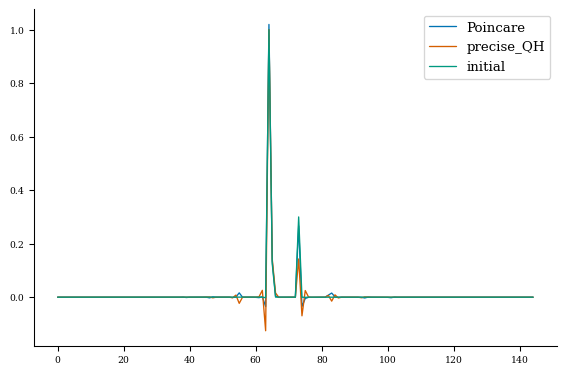

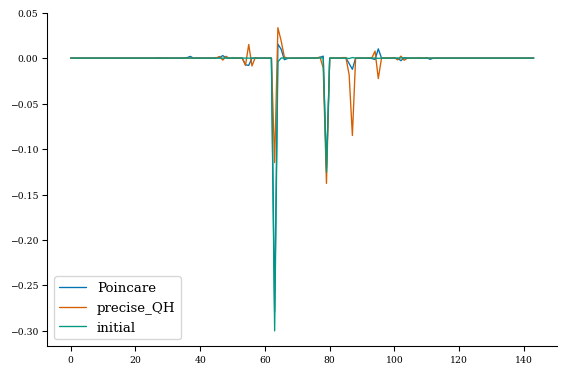

In [67]:
import matplotlib.pyplot as plt
eq00 = get("precise_QH")
eqp = eqfam[-1].copy()
eqp.xsection = eqp.get_surface_at(zeta=0)
eqp.surface = eqp.get_surface_at(rho=1)
eq00.xsection = eq00.get_surface_at(zeta=0)
eq00.surface = eq00.get_surface_at(rho=1)
plt.figure()
plt.plot(eqp.Rb_lmn, label="Poincare")
plt.plot(eq00.Rb_lmn, label="precise_QH")
plt.plot(eqfam[0].Rb_lmn, label="initial")
plt.legend();

plt.figure()
plt.plot(eqp.Zb_lmn, label="Poincare")
plt.plot(eq00.Zb_lmn, label="precise_QH")
plt.plot(eqfam[0].Zb_lmn, label="initial")
plt.legend()

In [68]:
for mode, l, p, i in zip(eq00.xsection.R_basis.modes, eq00.Rp_lmn, eqp.Rp_lmn, eqfam[0].Rp_lmn):
    print(
        f"Mode {mode}: precise_QH {l:^10.2e}, Poincare {p:^10.2e}, Initial {i:^10.2e}"
    )

Mode [0 0 0]: precise_QH  1.17e+00 , Poincare  1.28e+00 , Initial  1.29e+00 
Mode [1 1 0]: precise_QH  5.54e-02 , Poincare  1.13e-01 , Initial  1.25e-01 
Mode [2 0 0]: precise_QH -2.32e-02 , Poincare  1.17e-02 , Initial  1.09e-02 
Mode [2 2 0]: precise_QH  5.38e-02 , Poincare -1.35e-03 , Initial  3.20e-04 
Mode [3 1 0]: precise_QH  9.65e-04 , Poincare  7.71e-04 , Initial  1.14e-04 
Mode [3 3 0]: precise_QH -2.88e-03 , Poincare -6.75e-04 , Initial  1.02e-04 
Mode [4 0 0]: precise_QH  2.37e-03 , Poincare  2.38e-04 , Initial  2.38e-04 
Mode [4 2 0]: precise_QH -3.39e-03 , Poincare -3.00e-04 , Initial -3.00e-04 
Mode [4 4 0]: precise_QH -2.94e-04 , Poincare -9.43e-06 , Initial -9.43e-06 
Mode [5 1 0]: precise_QH  1.92e-05 , Poincare -5.74e-05 , Initial -5.74e-05 
Mode [5 3 0]: precise_QH -5.39e-05 , Poincare -1.01e-04 , Initial -1.01e-04 
Mode [5 5 0]: precise_QH  3.72e-05 , Poincare -9.61e-07 , Initial -9.61e-07 
Mode [6 0 0]: precise_QH -2.08e-04 , Poincare -8.60e-07 , Initial -8.60e-07 

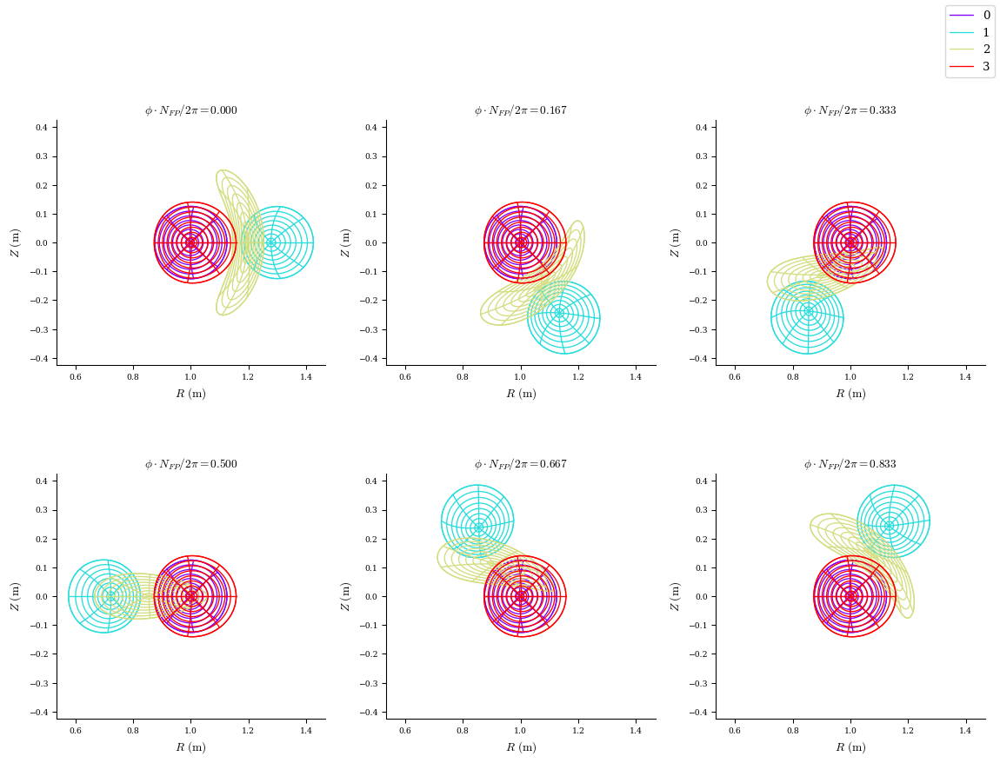

In [73]:
eqQH = get("precise_QH")
eqQHn0 = eqQH.copy()
eqQHn0.change_resolution(N=0)
eqQHn0.change_resolution(N=8)
eqn0 = eq.copy()
eqn0.change_resolution(N=0)
eqn0.change_resolution(N=8)
plot_comparison([eqn0, eq, eqQH, eqQHn0]);